#**Mount Google Drive**

In [1]:
from google.colab import drive
drive.mount('/content/drive/', force_remount=True)

Mounted at /content/drive/


#**Navigate to the project directory**

In [2]:
%cd /content/drive/MyDrive/visual-pollution-object-detection

/content/drive/MyDrive/visual-pollution-object-detection


In [ ]:
# Check the version of tensorflow
import tensorflow as tf
print(tf.__version__)

2.11.0


In [ ]:
# Check the version of Python
import sys
print(sys.version)

3.9.16 (main, Dec  7 2022, 01:11:51) 
[GCC 9.4.0]


In [3]:
# Import the necessary libraries 
import tensorflow as tf
import numpy as np
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import shutil
import random
import cv2
import glob
import os
from google.colab.patches import cv2_imshow
import time
import warnings
warnings.filterwarnings('ignore')

#from object_detection.utils import label_map_util
#from object_detection.utils import visualization_utils as viz_utils

#**Clone the tensorflow models git repository & Install TensorFlow Object Detection API**

In [ ]:
# clone the tensorflow models on the colab cloud vm
!git clone --q https://github.com/tensorflow/models.git

In [4]:
#navigate to /models/research folder to compile protos
%cd models/research

/content/drive/MyDrive/visual-pollution-object-detection/models/research


In [5]:
# Compile protos.
!protoc object_detection/protos/*.proto --python_out=.

In [6]:
# Install TensorFlow Object Detection API.
!cp object_detection/packages/tf2/setup.py .
!python -m pip install .

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Processing /content/drive/MyDrive/visual-pollution-object-detection/models/research
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.5/14.5 MB 23.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 352.1/352.1 KB 31.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 19.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 26.9/26.9 MB 37.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 KB 6.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.6/116.6 KB 4.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 238.9/238.9 KB 21.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.6/43.6 KB 5.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 630.1/

#**Test the model builder**

In [ ]:
!pwd

/content/drive/MyDrive/visual-pollution-object-detection/models/research


In [ ]:
# testing the model builder
!python object_detection/builders/model_builder_tf2_test.py

2023-02-13 19:40:33.290783: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-02-13 19:40:36.063243: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/nvidia/lib:/usr/local/nvidia/lib64
2023-02-13 19:40:36.063472: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/nvidia/lib:/usr/local/nvidia/lib64
2023-02-13 19:40:36.063501: W tensorfl

#**CSV annotations**
Here I will upload and verify the train and test CSV files that I already created in the previous step in ``the Pre-processing The dataset`` Jupyter notebook. 

In [ ]:
%cd /content/drive/MyDrive/visual-pollution-object-detection/data

/content/drive/MyDrive/visual-pollution-object-detection/data


##Load train csv annotations into Pandas dataframe

In [ ]:
# Read the CSV file (for train annotations)
train_df = pd.read_csv('train_labels.csv')

In [ ]:
# Get summary information of the train dataframe
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1200 entries, 0 to 1199
Data columns (total 7 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   class       1200 non-null   float64
 1   image_path  1200 non-null   object 
 2   name        1200 non-null   object 
 3   xmax        1200 non-null   float64
 4   xmin        1200 non-null   float64
 5   ymax        1200 non-null   float64
 6   ymin        1200 non-null   float64
dtypes: float64(5), object(2)
memory usage: 65.8+ KB


In [ ]:
# Get dimensions of the dataframe
train_df.shape

(1200, 7)

In [ ]:
# View the first 5 rows
train_df.head()

,class,image_path,name,xmax,xmin,ymax,ymin
0,3.0,4a48c42c9579ec0399e6c5a3e825e765.jpg,GARBAGE,1594.0,1402.0,524.0,422.0
1,3.0,4a48c42c9579ec0399e6c5a3e825e765.jpg,GARBAGE,1864.0,1572.0,658.0,476.0
2,3.0,4a48c42c9579ec0399e6c5a3e825e765.jpg,GARBAGE,1472.0,1314.0,550.0,458.0
3,7.0,ea906a663da6321bcef78be4b7d1afff.jpg,BAD_BILLBOARD,1972.0,1572.0,272.0,0.0
4,8.0,1c7d48005a12d1b19261b8e71df7cafe.jpg,SAND_ON_ROAD,1334.0,1098.0,456.0,358.0


#Check the total number of images for the training phase(the expected output is 500 images)

In [ ]:
images_name = train_df['image_path']

In [ ]:
images_name = images_name.sort_values().unique()

In [ ]:
print(len(images_name))

500


##Load test csv annotations into Pandas dataframe

In [ ]:
# Read the CSV file (for test annotations)
test_df = pd.read_csv('test_labels.csv')

In [ ]:
# Get summary information of the test dataframe
test_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 501 entries, 0 to 500
Data columns (total 7 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   class       501 non-null    float64
 1   image_path  501 non-null    object 
 2   name        501 non-null    object 
 3   xmax        501 non-null    float64
 4   xmin        501 non-null    float64
 5   ymax        501 non-null    float64
 6   ymin        501 non-null    float64
dtypes: float64(5), object(2)
memory usage: 27.5+ KB


In [ ]:
# Get dimensions of the dataframe
test_df.shape

(501, 7)

In [ ]:
# View the first 5 rows
test_df.head()

,class,image_path,name,xmax,xmin,ymax,ymin
0,3.0,a2fdbe4c36b8c7bc02ca83c4bfd968aa.jpg,GARBAGE,912.0,700.0,418.0,264.0
1,3.0,a2fdbe4c36b8c7bc02ca83c4bfd968aa.jpg,GARBAGE,812.0,638.0,418.0,282.0
2,3.0,a2fdbe4c36b8c7bc02ca83c4bfd968aa.jpg,GARBAGE,514.0,280.0,448.0,246.0
3,8.0,f6c36a813581be753d65682dafc16f1e.jpg,SAND_ON_ROAD,1592.0,1288.0,528.0,338.0
4,8.0,f6c36a813581be753d65682dafc16f1e.jpg,SAND_ON_ROAD,354.0,-20.0,582.0,362.0


#Check the total number of images for the testing phase(the expected output is 200 images)

In [ ]:
images_name = test_df['image_path']

In [ ]:
images_name = images_name.sort_values().unique()

In [ ]:
print(len(images_name))

200


#**Display annotations on a random train image**

In [ ]:
img=train_df.iloc[[10]]
img

,class,image_path,name,xmax,xmin,ymax,ymin
10,3.0,c12b006174423ceb3e2e3563a8ca7751.jpg,GARBAGE,1196.0,936.0,1114.0,974.0


In [ ]:
img_name=train_df.iloc[10, 1]
img_name

'c12b006174423ceb3e2e3563a8ca7751.jpg'

In [ ]:
img_class=train_df.iloc[10, 2]
img_class

'GARBAGE'

In [ ]:
img_xmax=train_df.iloc[10, 3]
img_xmax

1196.0

In [ ]:
img_xmin=train_df.iloc[10, 4]
img_xmin

936.0

In [ ]:
img_ymax=train_df.iloc[10, 5]
img_ymax

1114.0

In [ ]:
img_ymin=train_df.iloc[10, 6]
img_ymin

974.0

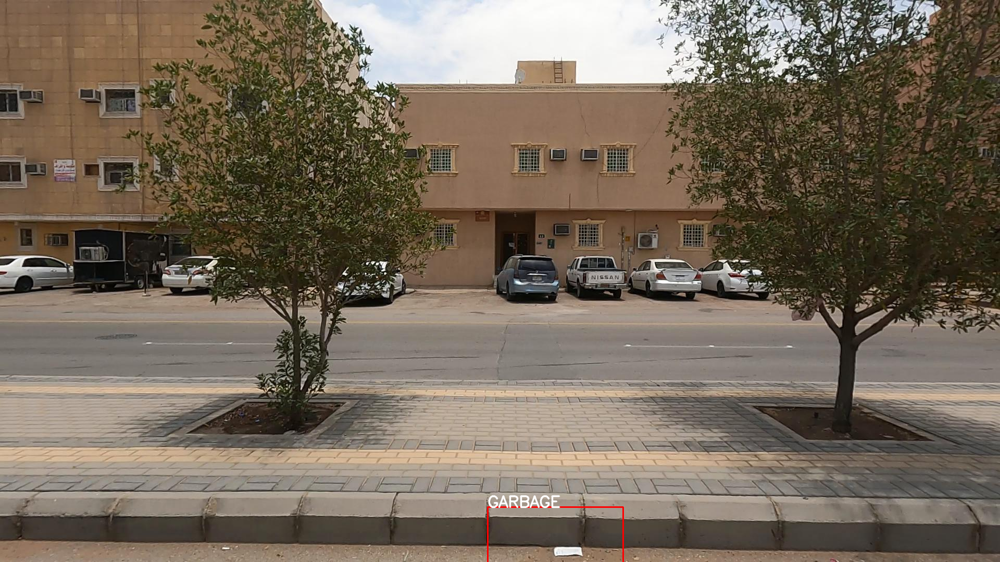

In [ ]:
path = '/content/drive/MyDrive/visual-pollution-object-detection/images/train/'
img_path = os.path.join(path,img_name)
image = cv2.imread(img_path)
start_point = img_xmax, img_ymax
end_point = img_xmin, img_ymin
# Red color in BGR
color = (0, 0, 255)
line_thickness= 2
image = cv2.rectangle(image, (int(start_point[0]), int(start_point[1])), (int(end_point[0]), int(end_point[1])), color, thickness=2)

x= int(end_point[0]) 
y= int(end_point[1]) 
image = cv2.putText(image, text=img_class, org=(x, y), fontFace=cv2.FONT_HERSHEY_SIMPLEX, fontScale=1, color=(255, 255, 255), thickness=2, lineType=cv2.LINE_AA)

#image = cv2.resize(image, (360, 340))            
cv2_imshow(image) 

#**Create & upload the label_map.pbtxt file inside the data/ folder**

item {

    id: 1
    name: 'BAD_BILLBOARD' 
}

item {

    id: 2
    name: 'BROKEN_SIGNAGE'
}

item {

    id: 3
    name: 'CLUTTER_SIDEWALK'
}

item {

    id: 4
    name: 'CONSTRUCTION_ROAD'
}

item {

    id: 5
    name: 'FADED_SIGNAGE'
}

item {

    id: 6
    name: 'GARBAGE'
}

item {

    id: 7
    name: 'GRAFFITI'
}

item {

    id: 8
    name: 'POTHOLES'
}

item {

    id: 9
    name: 'SAND_ON_ROAD'
}

item {
  
    id: 10
    name: 'UNKEPT_FACADE'
}

#**Create train.record & test.record files**

In [ ]:
%cd /content/drive/MyDrive/visual-pollution-object-detection

/content/drive/MyDrive/visual-pollution-object-detection


In [ ]:
!python3 generate_tfrecord.py --csv_input=data/train_labels.csv  --output_path=data/train.record  --image_dir='images/train'

2023-03-11 07:21:19.951737: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/lib/python3.9/dist-packages/cv2/../../lib64:/usr/lib64-nvidia
2023-03-11 07:21:19.951849: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/lib/python3.9/dist-packages/cv2/../../lib64:/usr/lib64-nvidia
2023-03-11 07:21:19.951962: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nvidia GPU with TensorRT, please make sure the missing libraries mentioned above are installed properly.
Successfully created the TFRecords: /content/drive/MyDriv

In [ ]:
!python3 generate_tfrecord.py --csv_input=data/test_labels.csv  --output_path=data/test.record  --image_dir='images/test'

2023-03-11 07:27:17.122920: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/lib/python3.9/dist-packages/cv2/../../lib64:/usr/lib64-nvidia
2023-03-11 07:27:17.123034: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/lib/python3.9/dist-packages/cv2/../../lib64:/usr/lib64-nvidia
2023-03-11 07:27:17.123053: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nvidia GPU with TensorRT, please make sure the missing libraries mentioned above are installed properly.
Successfully created the TFRecords: /content/drive/MyDriv

In [ ]:
%cd data/

/content/drive/MyDrive/visual-pollution-object-detection/data


In [ ]:
!ls

inference_graph					      test_labels.csv
label_map.pbtxt					      test.record
ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8	      train_labels.csv
ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz  train.record


#**Download pre-trained model checkpoint**
#**inside the data/ folder**

In [ ]:
%cd /content/drive/MyDrive/visual-pollution-object-detection/data/

/content/drive/MyDrive/visual-pollution


In [ ]:
#Download the pre-trained model ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz into the data folder & unzip it.

!wget http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz
!tar -xzvf ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz

--2023-02-11 23:47:16--  http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 74.125.196.128, 2607:f8b0:400c:c36::80
Connecting to download.tensorflow.org (download.tensorflow.org)|74.125.196.128|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 20515344 (20M) [application/x-tar]
Saving to: ‘ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz’

ssd_mobilenet_v2_fp 100%[===================>]  19.56M  43.0MB/s    in 0.5s    

2023-02-11 23:47:17 (43.0 MB/s) - ‘ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz’ saved [20515344/20515344]

ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/
ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/checkpoint/
ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/checkpoint/ckpt-0.data-00000-of-00001
ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/checkpoint/checkpoint
ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-

#**Make changes to the model pipeline config file**

Navigate to this configuration file

 ``/content/drive/MyDrive/visual-pollution-object-detection/models/research/object_detection/configs/tf2/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.config``
 
open it and make the following changes :

* change ``num_classes`` to ``num_classes: 10``


* change ``fine_tune_checkpoint`` to  ``fine_tune_checkpoint: "/content/drive/MyDrive/visual-pollution-object-detection/data/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/checkpoint/ckpt-0"``

* change ``fine_tune_checkpoint_type`` to  ``fine_tune_checkpoint_type: "detection"``

* change ``batch_size`` to ``batch_size: 24``

* change ``num_steps`` to ``num_steps: 2000``

* change ``label_map_path`` to ``label_map_path: "/content/drive/MyDrive/visual-pollution-object-detection/data/label_map.pbtxt"``

* change ``input_path`` to ``input_path: "/content/drive/MyDrive/visual-pollution-object-detection/data/train.record"``

* change ``label_map_path`` to ``label_map_path: "/content/drive/MyDrive/visual-pollution-object-detection/data/label_map.pbtxt"``

* change ``input_path`` to ``input_path: "/content/drive/MyDrive/visual-pollution-object-detection/data/test.record"``


#**Load Tensorboard**

In [ ]:
%cd /content/drive/MyDrive/visual-pollution-object-detection/data/

/content/drive/MyDrive/visual-pollution-object-detection/data


In [ ]:
#load tensorboard

%load_ext tensorboard
%tensorboard --logdir '/content/drive/MyDrive/visual-pollution-object-detection/training'

<IPython.core.display.Javascript object>

#**To avoid the 'Runtime Disconnected Due to Inactivity' error in Google colab while training the model**

Ctrl+ Shift + I to open developer-settings in your web-browser ---> then go to console tab ---> and then type on the console prompt the following code (a JavaScript interval to click on the connect button every 60 seconds):

In [ ]:
function ClickConnect(){
    console.log("Working"); 
    document.querySelector("colab-toolbar-button").click() 
}

var colab = setInterval(ClickConnect,60000);

#**To stop the function (stop clicking on the button)**

Ctrl+ Shift + I to open developer-settings in your web-browser ---> then go to console tab ---> and then type on the console prompt the following code:

In [ ]:
clearInterval(colab)

#**Train the model**

In [ ]:
%cd /content/drive/MyDrive/visual-pollution-object-detection/models/research/object_detection 

/content/drive/MyDrive/visual-pollution-object-detection/models/research/object_detection


In [ ]:
!python3 model_main_tf2.py --pipeline_config_path=/content/drive/MyDrive/visual-pollution-object-detection/models/research/object_detection/configs/tf2/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.config --model_dir=/content/drive/MyDrive/visual-pollution-object-detection/training --alsologtostderr

2023-02-13 19:42:29.483107: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-02-13 19:42:30.837187: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/nvidia/lib:/usr/local/nvidia/lib64
2023-02-13 19:42:30.837315: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/nvidia/lib:/usr/local/nvidia/lib64
2023-02-13 19:42:30.837355: W tensorfl

#**Export the inference graph**

In [ ]:
%cd /content/drive/MyDrive/visual-pollution-object-detection/models/research/object_detection

/content/drive/MyDrive/visual-pollution-object-detection/models/research/object_detection


In [ ]:
##Export inference graph
!python exporter_main_v2.py --trained_checkpoint_dir=/content/drive/MyDrive/visual-pollution-object-detection/training --pipeline_config_path=/content/drive/MyDrive/visual-pollution-object-detection/models/research/object_detection/configs/tf2/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.config --output_directory=/content/drive/MyDrive/visual-pollution-object-detection/data/inference_graph

2023-02-15 22:48:53.328359: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-02-15 22:48:57.241977: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/nvidia/lib:/usr/local/nvidia/lib64
2023-02-15 22:48:57.242186: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/nvidia/lib:/usr/local/nvidia/lib64
2023-02-15 22:48:57.242214: W tensorfl

#**Download a font for object detection box**

In [33]:
%cd /content/drive/MyDrive/visual-pollution-object-detection/models/research/object_detection

/content/drive/MyDrive/visual-pollution-object-detection/models/research/object_detection


In [34]:
# Different font-type for labels text.(This step is optional)
!wget https://freefontsdownload.net/download/160187/arial.zip
!unzip arial.zip -d .

%cd utils/
!sed -i "s/font = ImageFont.truetype('arial.ttf', 24)/font = ImageFont.truetype('arial.ttf', 30)/" visualization_utils.py
%cd ..

--2023-03-13 12:29:33--  https://freefontsdownload.net/download/160187/arial.zip
Resolving freefontsdownload.net (freefontsdownload.net)... 104.21.75.182, 172.67.180.27, 2606:4700:3036::6815:4bb6, ...
Connecting to freefontsdownload.net (freefontsdownload.net)|104.21.75.182|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 172821 (169K) [application/force-download]
Saving to: ‘arial.zip’

arial.zip           100%[===================>] 168.77K   406KB/s    in 0.4s    

2023-03-13 12:29:34 (406 KB/s) - ‘arial.zip’ saved [172821/172821]

Archive:  arial.zip
@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@
@#################################@
@#        Downloaded from        #@
@#                               #@
@#   www.FreeFontsDownload.net   #@
@#                               #@
@# ---------- More site -------- #@
@#      https://funnytv.net      #@
@#                               #@
@#                               #@
@#################################@
@@@@@@@@@@@@@@@@@@@

#**Test the custom Object Detection model:**

#Run inference and make predictions on images

In [39]:
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils

In [40]:
#Loading the saved_model
PATH_TO_SAVED_MODEL="/content/drive/MyDrive/visual-pollution-object-detection/data/inference_graph/saved_model"
print('Loading model...', end='')

# Load saved model and build the detection function
detect_fn=tf.saved_model.load(PATH_TO_SAVED_MODEL)
print('Done!')

Loading model...Done!


In [41]:
#Loading the label_map
category_index=label_map_util.create_category_index_from_labelmap("/content/drive/MyDrive/visual-pollution-object-detection/data/label_map.pbtxt",use_display_name=True)

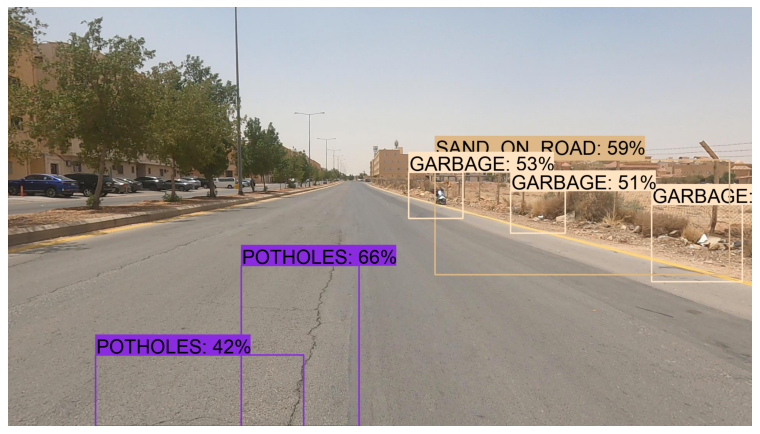

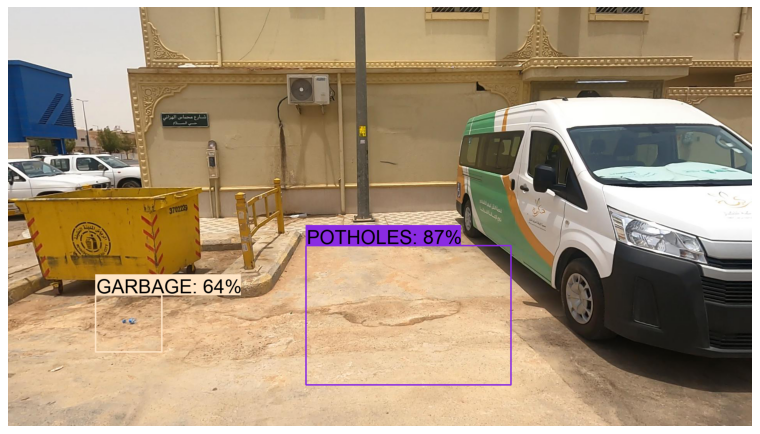

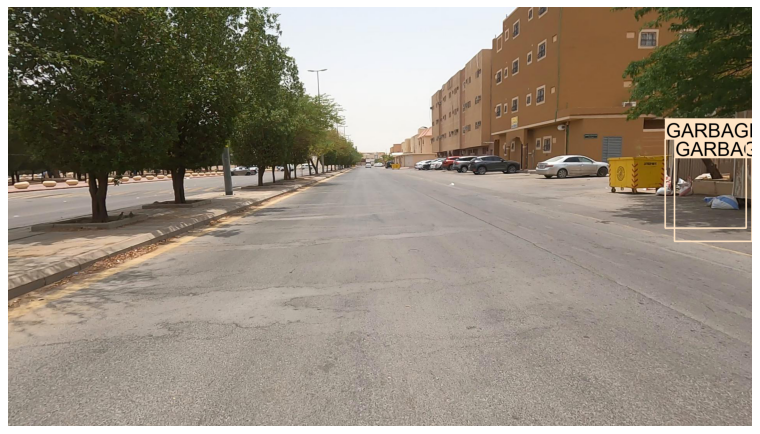

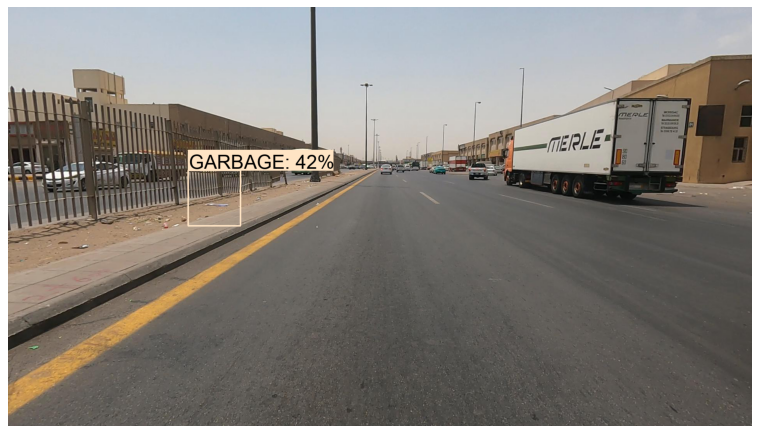

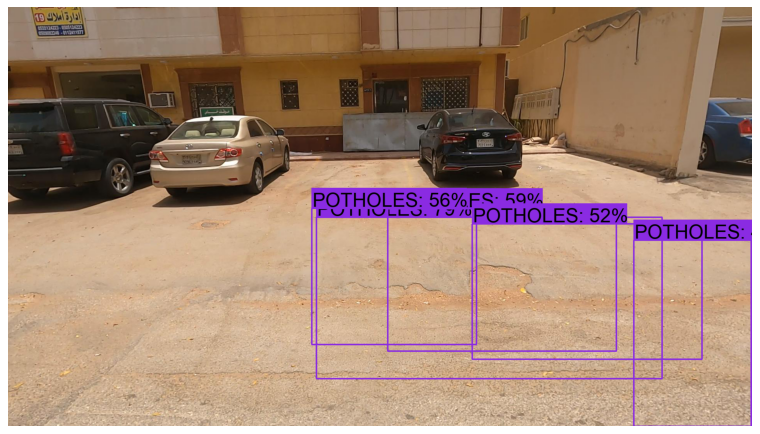

...

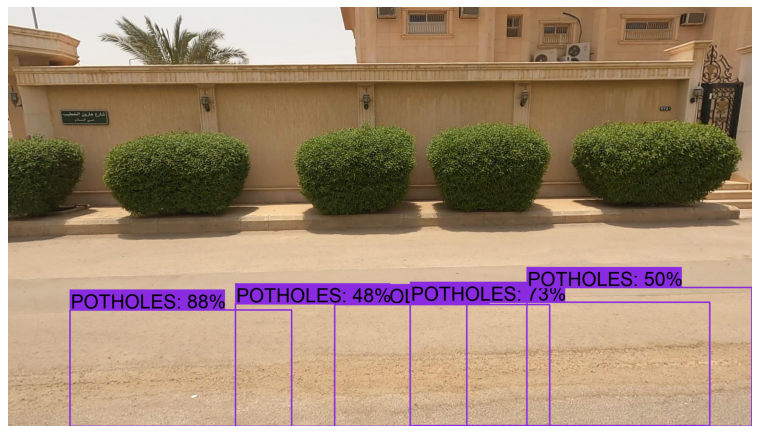

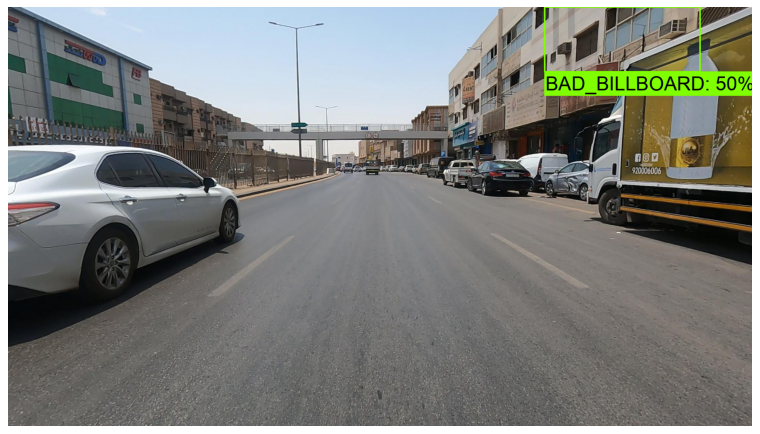

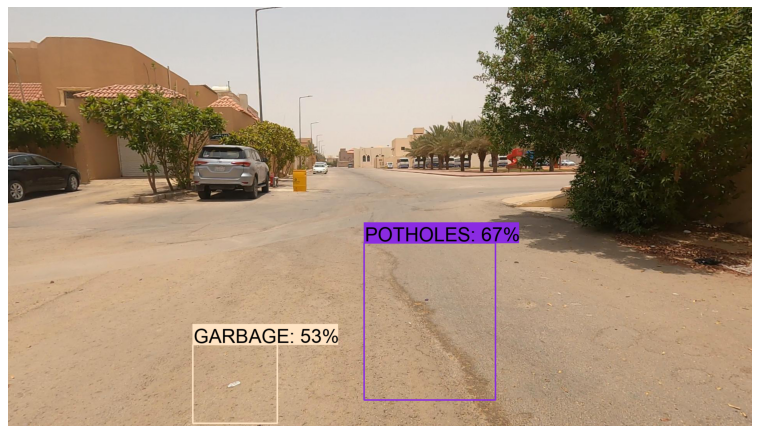

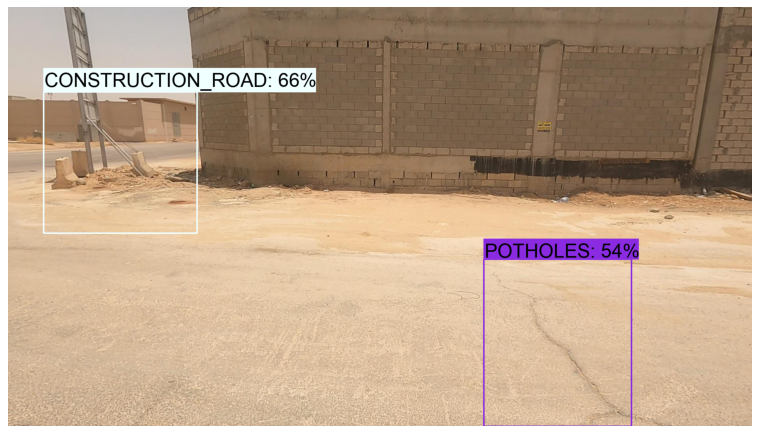

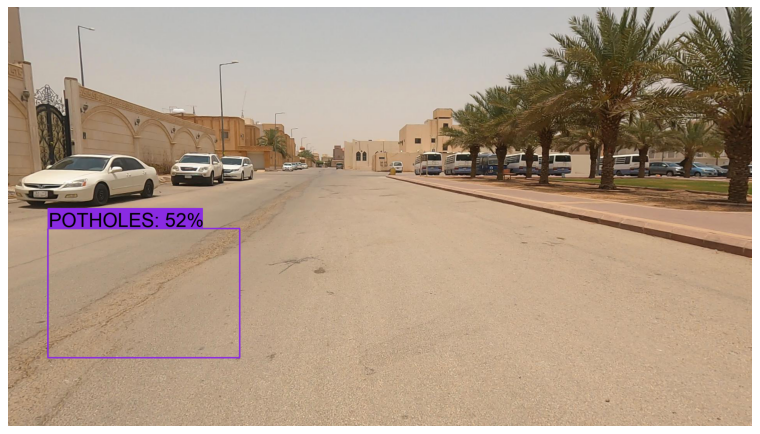

In [42]:
img_dir = "/content/drive/MyDrive/visual-pollution-object-detection/inference_images/*.*"

for file in glob.glob(img_dir):

      def load_image_into_numpy_array(path):

        return np.array(Image.open(path))

      #Preprocess the image for inferecne

      image_np = load_image_into_numpy_array(file)
      # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
      input_tensor = tf.convert_to_tensor(image_np)
      # The model expects a batch of images, so add an axis with `tf.newaxis`.
      input_tensor = input_tensor[tf.newaxis, ...]

      detections = detect_fn(input_tensor)

      # All outputs are batches tensors.
      # Convert to numpy arrays, and take index [0] to remove the batch dimension.
      # We're only interested in the first num_detections.
      num_detections = int(detections.pop('num_detections'))
      detections = {key: value[0, :num_detections].numpy()
                    for key, value in detections.items()}
      detections['num_detections'] = num_detections

      # detection_classes should be ints.
      detections['detection_classes'] = detections['detection_classes'].astype(np.int64)

      image_np_with_detections = image_np.copy()

      viz_utils.visualize_boxes_and_labels_on_image_array(
            image_np_with_detections,
            detections['detection_boxes'],
            detections['detection_classes'],
            detections['detection_scores'],
            category_index,
            use_normalized_coordinates=True,
            max_boxes_to_draw=200,
            min_score_thresh=.4, # Adjust this value to set the minimum probability boxes to be classified as True
            agnostic_mode=False)

      IMAGE_SIZE = (12, 8) # Output display size as you want

      %matplotlib inline
      plt.figure(figsize=IMAGE_SIZE, dpi=80)
      plt.axis("off")
      plt.imshow(image_np_with_detections)
      plt.show()
